### Frame extraction from video

In [133]:
import cv2
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

In [194]:
video_root = '/Users/strezoski/Projects/ml/datasets/'
frame_dir = 'frames/'
vidcap = cv2.VideoCapture(video_root+'/00053.mp4')

frame_count= int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))

print("The total number of frames in this video is ", totalframecount)

success,image = vidcap.read()
count = 0

for frame_id in tqdm(range(frame_count)):
    cv2.imwrite(video_root+frame_dir+"frame_{video_id}_{frame_id}_frame.jpg".format(video_id='00053', frame_id=count), image)
    success,image = vidcap.read()
    count+=1

The total number of frames in this video is  100


100%|████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:00<00:00, 467.41it/s]


### 3DDFA Initialization

-> Maybe change the face detector and use Yolo v5 instead of FaceBoxes. https://github.com/deepcam-cn/yolov5-face
-> Optional: test out the face detector and compare to Yolo.

In [135]:
import yaml

from FaceBoxes import FaceBoxes
from TDDFA import TDDFA
from utils.functions import draw_landmarks
from utils.render import render
from utils.depth import depth

import numpy as np
import matplotlib.pyplot as plt

cfg = yaml.load(open('configs/mb1_120x120.yml'), Loader=yaml.SafeLoader)


onnx_flag = True
if onnx_flag:
    import os
    os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'
    os.environ['OMP_NUM_THREADS'] = '4'
    
    from FaceBoxes.FaceBoxes_ONNX import FaceBoxes_ONNX
    from TDDFA_ONNX import TDDFA_ONNX
    
    face_boxes = FaceBoxes_ONNX()
    tddfa = TDDFA_ONNX(**cfg)
else:
    tddfa = TDDFA(gpu_mode=False, **cfg)
    face_boxes = FaceBoxes()

### Select frame folder and load frames

In [195]:
from os import walk

frame_file_locations = [os.path.join(video_root+frame_dir, file) for file in next(walk(video_root+frame_dir), (None, None, []))[2]]

### Start frame processing

Our workflow consists of the following steps:
1. Fetch a frame after extraction
2. Run face detection
3. Apply 3DDFA to each frame
4. Compute Euler Angles
5. Store landmarks in a dataframe
6. Export dataframe to HDF5 dataset
7. Repeat this iteration for every step in curriculum.

In [196]:
# A dictionary containing all frames, their face bounding boxes, 3DMM parameters, reconstructed vertices, flags.
face_bboxes = {}

for frame in tqdm(frame_file_locations):
    img = cv2.imread(frame)
    try:
        boxes = face_boxes(img)
        face_bboxes[frame.split("/")[-1][:-4]] = [boxes]

        # Optimize for 3DDM parameters.
        param_lst, roi_box_lst = tddfa(img, boxes)
        # We don't need all landmarks for now.
        dense_flag = False

        ver_lst = tddfa.recon_vers(param_lst, roi_box_lst, dense_flag=dense_flag)
        face_bboxes[frame.split("/")[-1][:-4]].append([param_lst, roi_box_lst, ver_lst, dense_flag])
    except:
        pass
    # draw_landmarks(img, ver_lst, dense_flag=dense_flag)

100%|████████████████████████████████████████████████████████████████████████████████████████| 220/220 [00:01<00:00, 117.63it/s]


In [138]:
from utils.pose import P2sRt as decompose_camera_matrix
from utils.pose import matrix2angle, plot_pose_box, plot_image

### Utility functions
1. Pose Calculation
2. Pose Rendering
3. Bbox crop for manual videos

In [182]:
import pandas as pd

# Calculate the euler angles and return the pose (with orientation, w/o scale)
def calculate_pose(param, augment_coeffs=[0,0,0]):
    P = param[:12].reshape(3, -1)  # camera matrix
    s, R, t3d = decompose_camera_matrix(P)
    # Yaw, Pitch and Roll
    P = np.concatenate((R, t3d.reshape(3, -1)), axis=1)  # without scale
    pose = matrix2angle(R)
    # if some augmentation is in order
    pose = [p + aug for (p, aug) in zip(pose, augment_coeffs)]
    # convert to radians
    pose = [p * 180 / np.pi for p in pose]
    return P, pose

# Visualize the pose.
def render_pose(img, param_lst, ver_ls, verbose=False):
    
    for param, ver in zip(param_lst, ver_lst):
        P, pose = calculate_pose(param)
        img = plot_pose_box(img, P, ver)
        if verbose:
            print(f'Yaw: {pose[0]:.1f}, Pitch: {pose[1]:.1f}, Roll: {pose[2]:.1f}')
        # plot_image(img)

    return img

# Crop to bbox
def crop_img(img, roi_box):
    h, w = img.shape[:2]

    sx, sy, ex, ey = [int(round(_)) for _ in roi_box]
    dh, dw = ey - sy, ex - sx
    if len(img.shape) == 3:
        res = np.zeros((dh, dw, 3), dtype=np.uint8)
    else:
        res = np.zeros((dh, dw), dtype=np.uint8)
    if sx < 0:
        sx, dsx = 0, -sx
    else:
        dsx = 0

    if ex > w:
        ex, dex = w, dw - (ex - w)
    else:
        dex = dw

    if sy < 0:
        sy, dsy = 0, -sy
    else:
        dsy = 0

    if ey > h:
        ey, dey = h, dh - (ey - h)
    else:
        dey = dh

    res[dsy:dey, dsx:dex] = img[sy:ey, sx:ex]
    return res

# Just create the dict where the anotations will be stored.
def create_video_df():
    
    df = pd.DataFrame({"person_id": list(), "instance_id": list(), "video_id":list(), "frame_id":list(), "pose":list()})
    return df

def add_to_video_df(df, person_id, instance_id, video_id, frame_id, pose):

    df = df.append({"person_id": person_id, "instance_id": instance_id, "video_id":video_id, "frame_id":frame_id, "pose":pose}, ignore_index=True)
    return df

### Case Study 1

We'll just take one video, decompose it to frames run 3ddfa and render the pose params in a plot.

  2%|██                                                                                         | 5/220 [00:00<00:08, 24.28it/s]

Yaw: -39.0, Pitch: -4.6, Roll: 1.9
Yaw: -24.6, Pitch: -6.9, Roll: 1.3
Yaw: -22.7, Pitch: 8.2, Roll: 10.7
Yaw: -30.3, Pitch: 13.4, Roll: 10.2
Yaw: -16.0, Pitch: 8.4, Roll: 16.0
Yaw: 9.7, Pitch: -1.1, Roll: 2.9


  5%|████▌                                                                                     | 11/220 [00:00<00:07, 27.11it/s]

Yaw: 6.5, Pitch: 0.3, Roll: 4.8
Yaw: -32.0, Pitch: -7.6, Roll: 1.8
Yaw: -23.2, Pitch: 8.0, Roll: 11.7
Yaw: 7.5, Pitch: 0.8, Roll: 4.4
Yaw: -20.5, Pitch: 7.3, Roll: 7.8
Yaw: -33.5, Pitch: -1.7, Roll: 4.2
Yaw: -35.6, Pitch: -4.4, Roll: 3.5


  6%|█████▋                                                                                    | 14/220 [00:00<00:07, 27.61it/s]

Yaw: -10.1, Pitch: 0.3, Roll: 6.5
Yaw: 9.6, Pitch: -0.7, Roll: 3.9
Yaw: -22.5, Pitch: 7.4, Roll: 12.1
Yaw: -29.7, Pitch: 10.6, Roll: 10.1
Yaw: -38.5, Pitch: -4.2, Roll: 3.0


 11%|█████████▊                                                                                | 24/220 [00:01<00:11, 17.25it/s]

Yaw: -18.3, Pitch: 6.7, Roll: 14.4
Yaw: -14.7, Pitch: 4.5, Roll: 8.3
Yaw: -28.0, Pitch: 10.6, Roll: 9.1
Yaw: -16.0, Pitch: -2.0, Roll: 5.7
Yaw: -22.4, Pitch: 6.1, Roll: 8.5
Yaw: -20.5, Pitch: 5.9, Roll: 7.1


 12%|███████████                                                                               | 27/220 [00:01<00:09, 19.63it/s]

Yaw: 6.2, Pitch: -1.3, Roll: 4.3
Yaw: -35.1, Pitch: -4.5, Roll: 3.0
Yaw: -20.4, Pitch: 6.6, Roll: 8.5
Yaw: 4.5, Pitch: 1.2, Roll: 3.8
Yaw: -23.1, Pitch: 8.2, Roll: 11.9
Yaw: -34.7, Pitch: -2.1, Roll: 3.2


 17%|███████████████▏                                                                          | 37/220 [00:01<00:06, 26.98it/s]

Yaw: -19.0, Pitch: 5.0, Roll: 8.9
Yaw: -21.3, Pitch: 7.8, Roll: 8.4
Yaw: 8.2, Pitch: -0.7, Roll: 4.4
Yaw: 9.6, Pitch: -1.1, Roll: 4.0
Yaw: -21.0, Pitch: 6.9, Roll: 12.6
Yaw: -34.7, Pitch: -4.1, Roll: 2.9
Yaw: -22.0, Pitch: 6.9, Roll: 7.7


 19%|████████████████▊                                                                         | 41/220 [00:01<00:07, 22.91it/s]

Yaw: -27.3, Pitch: 10.2, Roll: 11.0
Yaw: -26.8, Pitch: -8.4, Roll: 2.0
Yaw: -30.6, Pitch: 13.7, Roll: 10.9
Yaw: 8.5, Pitch: 1.6, Roll: 3.5


 21%|███████████████████▏                                                                      | 47/220 [00:02<00:07, 23.83it/s]

Yaw: -32.7, Pitch: -10.3, Roll: 2.1
Yaw: -17.9, Pitch: 7.7, Roll: 14.0
Yaw: 9.7, Pitch: 1.2, Roll: 2.9
Yaw: 4.5, Pitch: -0.7, Roll: 4.5
Yaw: 8.0, Pitch: -1.0, Roll: 3.8
Yaw: -21.6, Pitch: 6.1, Roll: 8.1


 24%|█████████████████████▋                                                                    | 53/220 [00:02<00:06, 25.67it/s]

Yaw: 4.1, Pitch: 0.1, Roll: 4.6
Yaw: -17.3, Pitch: 5.0, Roll: 7.6
Yaw: -30.5, Pitch: 11.5, Roll: 10.0
Yaw: -37.5, Pitch: -3.7, Roll: 3.6
Yaw: -30.6, Pitch: -9.2, Roll: 4.2
Yaw: -35.3, Pitch: -3.4, Roll: 2.7


 27%|████████████████████████▏                                                                 | 59/220 [00:02<00:06, 26.22it/s]

Yaw: -21.1, Pitch: 6.4, Roll: 7.8
Yaw: -27.5, Pitch: 11.2, Roll: 9.3
Yaw: -30.7, Pitch: 12.9, Roll: 9.8
Yaw: -17.5, Pitch: 7.3, Roll: 15.0
Yaw: 9.1, Pitch: -1.4, Roll: 3.8
Yaw: 6.5, Pitch: -1.9, Roll: 4.7


 28%|█████████████████████████▎                                                                | 62/220 [00:02<00:05, 26.78it/s]

Yaw: -32.2, Pitch: -5.6, Roll: 2.9
Yaw: -24.6, Pitch: -6.2, Roll: 1.6
Yaw: -38.6, Pitch: -3.4, Roll: 2.9
Yaw: -25.1, Pitch: 9.4, Roll: 10.1


 31%|███████████████████████████▊                                                              | 68/220 [00:03<00:07, 21.62it/s]

Yaw: -34.8, Pitch: -2.6, Roll: 4.6
Yaw: -7.8, Pitch: -0.6, Roll: 5.8
Yaw: 9.4, Pitch: -1.4, Roll: 4.1
Yaw: -22.0, Pitch: 7.3, Roll: 11.6
Yaw: -22.9, Pitch: 7.4, Roll: 11.2
Yaw: -20.9, Pitch: 7.8, Roll: 7.9


 34%|██████████████████████████████▎                                                           | 74/220 [00:03<00:05, 24.62it/s]

Yaw: 8.0, Pitch: 0.2, Roll: 4.4
Yaw: -33.7, Pitch: -2.2, Roll: 3.6
Yaw: -28.4, Pitch: 11.7, Roll: 9.4
Yaw: -12.6, Pitch: 0.6, Roll: 5.8
Yaw: -24.9, Pitch: 6.4, Roll: 7.0
Yaw: -29.5, Pitch: 10.3, Roll: 10.2
Yaw: -38.0, Pitch: -4.2, Roll: 3.0


 36%|████████████████████████████████▋                                                         | 80/220 [00:03<00:05, 24.95it/s]

Yaw: -18.0, Pitch: 6.8, Roll: 14.3
Yaw: -15.2, Pitch: 5.5, Roll: 8.7
Yaw: -20.4, Pitch: 6.9, Roll: 8.7
Yaw: 3.8, Pitch: 0.9, Roll: 4.4
Yaw: -22.0, Pitch: 8.3, Roll: 12.3
Yaw: -19.9, Pitch: 6.5, Roll: 7.6


 40%|████████████████████████████████████▍                                                     | 89/220 [00:03<00:05, 26.11it/s]

Yaw: 6.7, Pitch: -0.8, Roll: 4.2
Yaw: -34.5, Pitch: -3.8, Roll: 3.2
Yaw: 9.8, Pitch: -1.1, Roll: 3.9
Yaw: -22.0, Pitch: 6.4, Roll: 12.2
Yaw: -34.9, Pitch: -4.5, Roll: 2.4
Yaw: -21.2, Pitch: 7.3, Roll: 7.7
Yaw: -34.9, Pitch: -2.0, Roll: 3.8
Yaw: -17.2, Pitch: 5.2, Roll: 8.8
Yaw: 9.0, Pitch: -0.5, Roll: 3.3


 43%|██████████████████████████████████████▊                                                   | 95/220 [00:04<00:06, 19.64it/s]

Yaw: -21.2, Pitch: 7.2, Roll: 8.9
Yaw: 9.1, Pitch: 1.8, Roll: 3.3
Yaw: -32.7, Pitch: -8.3, Roll: 2.6
Yaw: -17.6, Pitch: 8.2, Roll: 14.0
Yaw: 9.8, Pitch: 0.5, Roll: 3.2
Yaw: -29.9, Pitch: 11.7, Roll: 10.7


 46%|████████████████████████████████████████▊                                                | 101/220 [00:04<00:05, 22.60it/s]

Yaw: -29.1, Pitch: -9.0, Roll: 3.3
Yaw: -30.9, Pitch: 14.7, Roll: 11.6
Yaw: 8.6, Pitch: -0.2, Roll: 3.5
Yaw: -20.6, Pitch: 6.7, Roll: 8.5
Yaw: 5.0, Pitch: 0.8, Roll: 4.8
Yaw: 5.3, Pitch: 0.0, Roll: 4.6


 49%|███████████████████████████████████████████▎                                             | 107/220 [00:04<00:04, 23.01it/s]

Yaw: -34.9, Pitch: -3.5, Roll: 2.8
Yaw: -29.7, Pitch: -10.4, Roll: 2.9
Yaw: -21.4, Pitch: 6.3, Roll: 7.6
Yaw: -25.6, Pitch: 10.8, Roll: 9.9
Yaw: -16.4, Pitch: 5.2, Roll: 7.7
Yaw: -31.1, Pitch: 12.0, Roll: 10.4


 52%|██████████████████████████████████████████████                                           | 114/220 [00:05<00:04, 26.18it/s]

Yaw: -37.0, Pitch: -4.3, Roll: 3.0
Yaw: 8.0, Pitch: -0.6, Roll: 4.8
Yaw: -20.2, Pitch: 6.2, Roll: 7.2
Yaw: -22.7, Pitch: 6.4, Roll: 11.1
Yaw: -33.4, Pitch: -4.2, Roll: 2.9
Yaw: -35.1, Pitch: -3.8, Roll: 3.8
Yaw: -22.7, Pitch: 8.0, Roll: 12.0


 56%|█████████████████████████████████████████████████▊                                       | 123/220 [00:05<00:03, 27.63it/s]

Yaw: 9.6, Pitch: -0.8, Roll: 4.6
Yaw: -25.1, Pitch: -8.3, Roll: -0.4
Yaw: -19.3, Pitch: 6.2, Roll: 13.2
Yaw: 7.8, Pitch: 0.9, Roll: 3.4
Yaw: -17.2, Pitch: 8.9, Roll: 15.8
Yaw: -33.4, Pitch: -3.7, Roll: 3.5
Yaw: 6.6, Pitch: 1.2, Roll: 4.7


 57%|██████████████████████████████████████████████████▉                                      | 126/220 [00:05<00:03, 27.24it/s]

Yaw: -27.7, Pitch: 7.3, Roll: 7.5
Yaw: 8.2, Pitch: 0.7, Roll: 4.0
Yaw: 5.8, Pitch: -0.8, Roll: 4.6
Yaw: -1.5, Pitch: 0.2, Roll: 4.9


 60%|█████████████████████████████████████████████████████▍                                   | 132/220 [00:05<00:04, 19.66it/s]

Yaw: -19.5, Pitch: 7.4, Roll: 8.6
Yaw: -24.4, Pitch: -6.7, Roll: 1.2
Yaw: -38.9, Pitch: -3.5, Roll: 2.9
Yaw: -28.8, Pitch: 8.9, Roll: 8.9
Yaw: -15.2, Pitch: 5.1, Roll: 8.4
Yaw: -29.4, Pitch: 11.6, Roll: 8.9


 63%|███████████████████████████████████████████████████████▊                                 | 138/220 [00:06<00:03, 22.88it/s]

Yaw: 9.0, Pitch: 0.2, Roll: 4.1
Yaw: -22.8, Pitch: 6.4, Roll: 8.2
Yaw: -22.4, Pitch: -2.2, Roll: 5.3
Yaw: -20.7, Pitch: 6.5, Roll: 8.2
Yaw: -31.2, Pitch: 12.3, Roll: 10.3
Yaw: -24.8, Pitch: -7.3, Roll: 1.3


 65%|██████████████████████████████████████████████████████████▎                              | 144/220 [00:06<00:03, 24.64it/s]

Yaw: -35.6, Pitch: -3.7, Roll: 2.5
Yaw: -30.5, Pitch: -10.1, Roll: 3.8
Yaw: 7.6, Pitch: 0.8, Roll: 5.0
Yaw: 9.0, Pitch: 0.1, Roll: 3.9
Yaw: -16.7, Pitch: 9.1, Roll: 15.1
Yaw: -37.6, Pitch: -2.7, Roll: 3.5


 68%|████████████████████████████████████████████████████████████▋                            | 150/220 [00:06<00:02, 26.05it/s]

Yaw: 5.4, Pitch: 1.1, Roll: 4.2
Yaw: -22.9, Pitch: 8.7, Roll: 8.9
Yaw: 8.5, Pitch: 0.2, Roll: 4.1
Yaw: -20.6, Pitch: 6.8, Roll: 10.3
Yaw: -20.9, Pitch: 7.2, Roll: 13.0
Yaw: 7.8, Pitch: -1.8, Roll: 4.0
Yaw: -35.3, Pitch: -3.5, Roll: 3.8


 72%|████████████████████████████████████████████████████████████████▎                        | 159/220 [00:06<00:02, 26.83it/s]

Yaw: -15.6, Pitch: 5.1, Roll: 8.0
Yaw: -36.5, Pitch: -4.3, Roll: 2.9
Yaw: -30.8, Pitch: 12.9, Roll: 10.7
Yaw: -21.2, Pitch: 6.7, Roll: 8.3
Yaw: 9.1, Pitch: 2.2, Roll: 3.1
Yaw: -28.7, Pitch: -2.2, Roll: 3.5
Yaw: -19.1, Pitch: 8.0, Roll: 13.3


 75%|██████████████████████████████████████████████████████████████████▊                      | 165/220 [00:07<00:02, 26.03it/s]

Yaw: -25.6, Pitch: 9.1, Roll: 9.3
Yaw: 5.4, Pitch: 0.2, Roll: 4.5
Yaw: -15.3, Pitch: 4.1, Roll: 8.7
Yaw: 5.2, Pitch: 0.5, Roll: 5.0
Yaw: -34.8, Pitch: -5.2, Roll: 1.7
Yaw: -21.3, Pitch: 6.7, Roll: 7.6


 78%|█████████████████████████████████████████████████████████████████████▏                   | 171/220 [00:07<00:01, 26.44it/s]

Yaw: -35.4, Pitch: -3.7, Roll: 3.5
Yaw: -22.2, Pitch: 8.2, Roll: 12.5
Yaw: 9.3, Pitch: -0.1, Roll: 4.1
Yaw: -20.5, Pitch: 7.3, Roll: 7.5
Yaw: 8.0, Pitch: 0.1, Roll: 4.7
Yaw: -21.8, Pitch: 6.6, Roll: 11.1


 80%|███████████████████████████████████████████████████████████████████████▌                 | 177/220 [00:07<00:02, 18.38it/s]

Yaw: -34.6, Pitch: -3.8, Roll: 3.2
Yaw: 7.3, Pitch: 0.8, Roll: 3.0
Yaw: -16.1, Pitch: 8.8, Roll: 16.4
Yaw: -34.4, Pitch: -5.1, Roll: 1.6
Yaw: 6.6, Pitch: 1.2, Roll: 4.6
Yaw: -25.9, Pitch: 7.6, Roll: 7.7


 83%|██████████████████████████████████████████████████████████████████████████               | 183/220 [00:08<00:01, 22.06it/s]

Yaw: -25.9, Pitch: -8.4, Roll: 0.3
Yaw: -22.7, Pitch: 6.6, Roll: 11.2
Yaw: -5.2, Pitch: -0.8, Roll: 5.2
Yaw: -20.0, Pitch: 6.4, Roll: 7.9
Yaw: 7.5, Pitch: 0.6, Roll: 4.0
Yaw: 5.9, Pitch: -1.2, Roll: 5.0


 86%|████████████████████████████████████████████████████████████████████████████▍            | 189/220 [00:08<00:01, 24.52it/s]

Yaw: -27.8, Pitch: 12.1, Roll: 9.4
Yaw: 9.0, Pitch: -0.7, Roll: 4.0
Yaw: -22.7, Pitch: 6.2, Roll: 8.4
Yaw: -18.4, Pitch: -3.0, Roll: 5.8
Yaw: -39.3, Pitch: -4.4, Roll: 1.7
Yaw: -29.5, Pitch: 9.5, Roll: 9.4


 89%|██████████████████████████████████████████████████████████████████████████████▉          | 195/220 [00:08<00:00, 26.45it/s]

Yaw: -14.8, Pitch: 5.0, Roll: 8.2
Yaw: -31.5, Pitch: -10.8, Roll: 4.1
Yaw: -36.2, Pitch: -3.5, Roll: 2.7
Yaw: 7.2, Pitch: 0.9, Roll: 4.5
Yaw: 9.3, Pitch: 1.1, Roll: 3.6
Yaw: -16.4, Pitch: 9.2, Roll: 15.1
Yaw: -22.9, Pitch: 6.8, Roll: 8.4


 91%|█████████████████████████████████████████████████████████████████████████████████▎       | 201/220 [00:08<00:00, 27.46it/s]

Yaw: -31.7, Pitch: 12.9, Roll: 10.4
Yaw: -25.5, Pitch: -7.6, Roll: 1.7
Yaw: -20.5, Pitch: 7.7, Roll: 13.1
Yaw: 8.7, Pitch: -1.0, Roll: 3.7
Yaw: -34.6, Pitch: -3.8, Roll: 3.4
Yaw: -34.9, Pitch: -1.7, Roll: 3.7


 94%|███████████████████████████████████████████████████████████████████████████████████▋     | 207/220 [00:08<00:00, 27.88it/s]

Yaw: 5.6, Pitch: 0.9, Roll: 4.2
Yaw: 8.4, Pitch: -0.0, Roll: 4.7
Yaw: -23.7, Pitch: 10.0, Roll: 9.3
Yaw: -19.7, Pitch: 6.3, Roll: 9.8
Yaw: -21.8, Pitch: 6.6, Roll: 8.5
Yaw: 9.9, Pitch: 2.1, Roll: 2.7
Yaw: -25.9, Pitch: -1.9, Roll: 4.3


 98%|███████████████████████████████████████████████████████████████████████████████████████▍ | 216/220 [00:09<00:00, 28.33it/s]

Yaw: -19.7, Pitch: 8.2, Roll: 13.8
Yaw: -23.6, Pitch: 8.7, Roll: 9.0
Yaw: -15.1, Pitch: 5.7, Roll: 8.6
Yaw: -36.1, Pitch: -4.0, Roll: 2.4
Yaw: -31.5, Pitch: 13.6, Roll: 10.9
Yaw: 5.4, Pitch: 1.0, Roll: 5.2
Yaw: -35.0, Pitch: -5.8, Roll: 1.7


100%|█████████████████████████████████████████████████████████████████████████████████████████| 220/220 [00:09<00:00, 23.55it/s]


Yaw: -20.6, Pitch: 6.6, Roll: 8.3
Yaw: 3.8, Pitch: -1.1, Roll: 4.8
Yaw: -15.7, Pitch: 4.2, Roll: 8.6


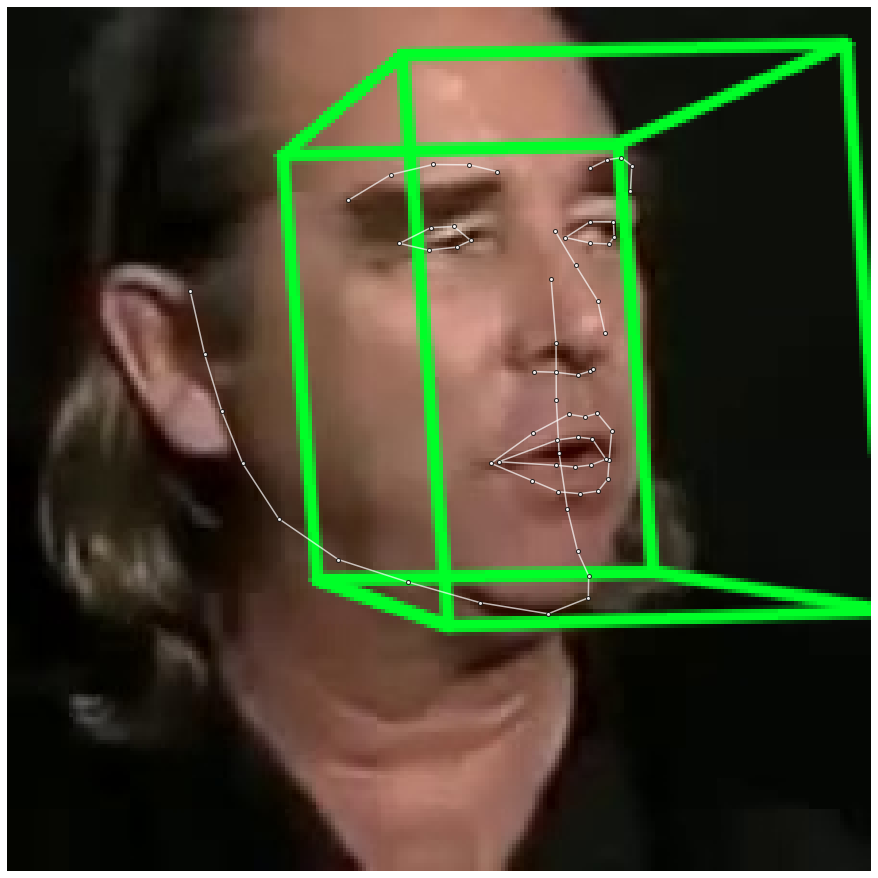

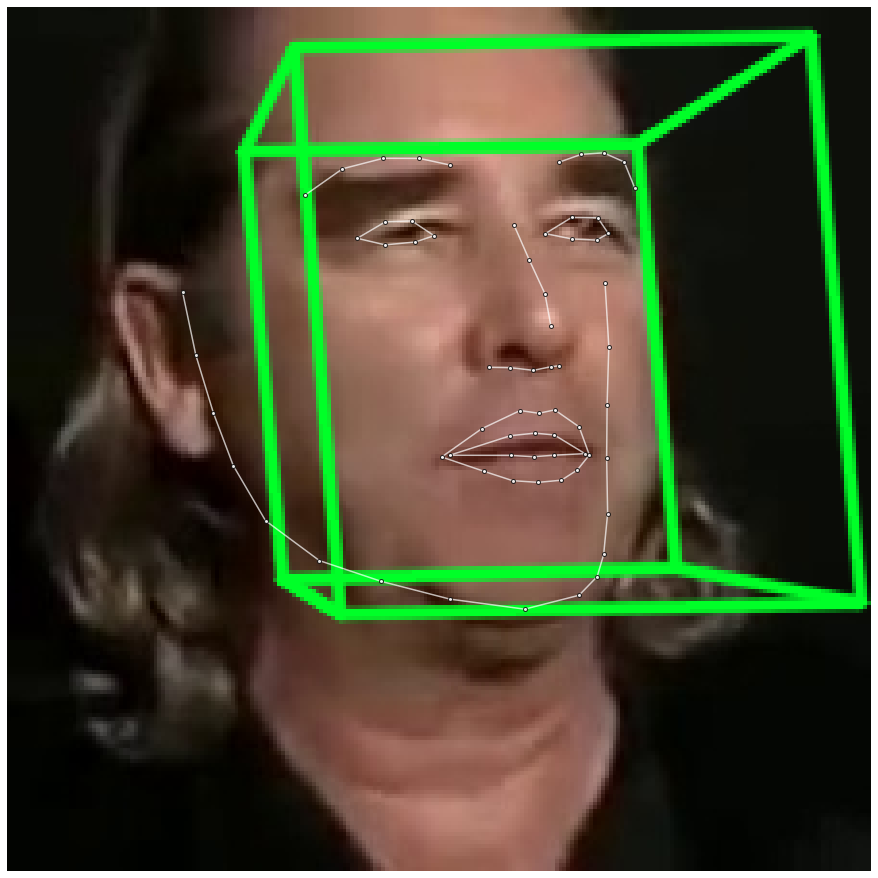

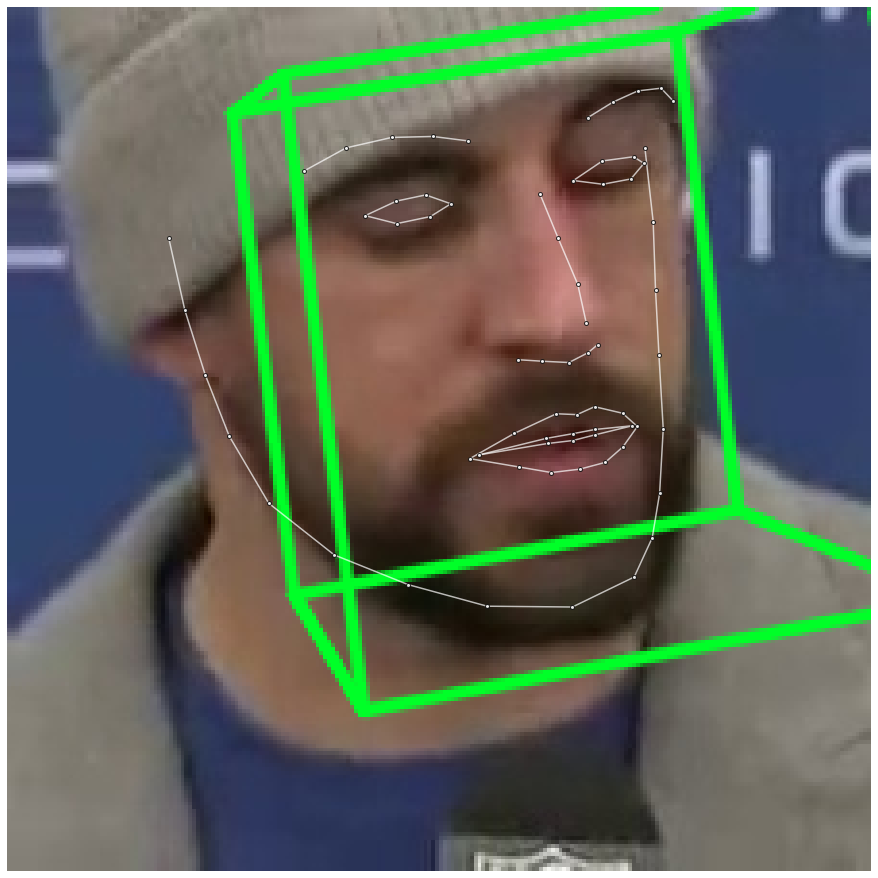

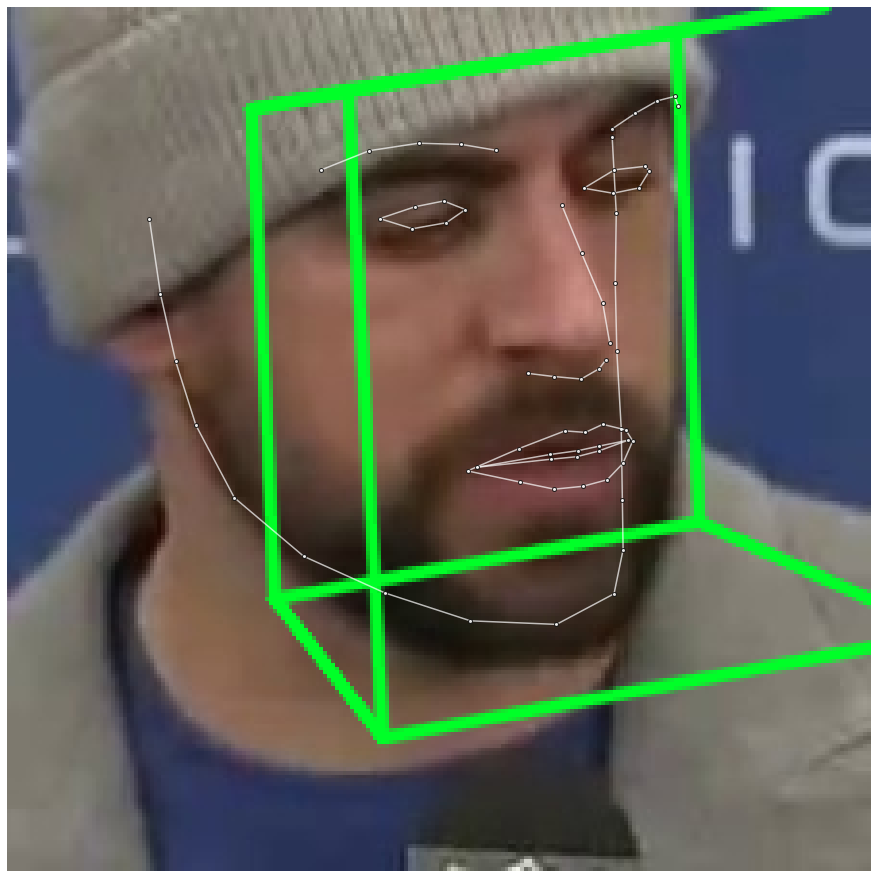

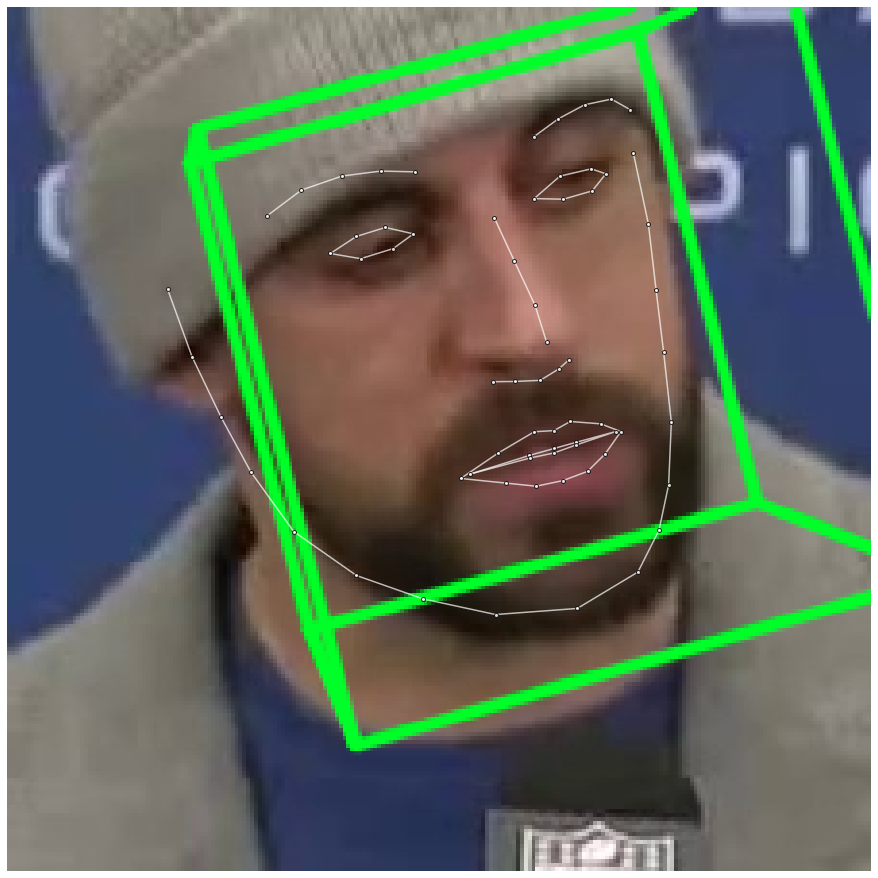

...

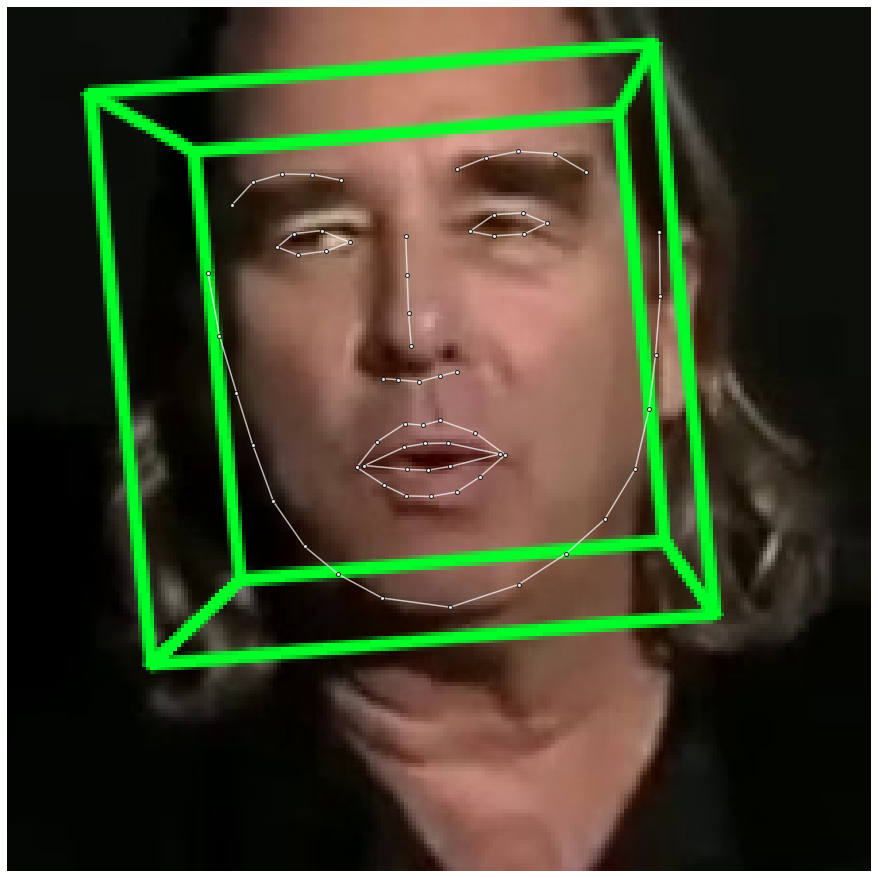

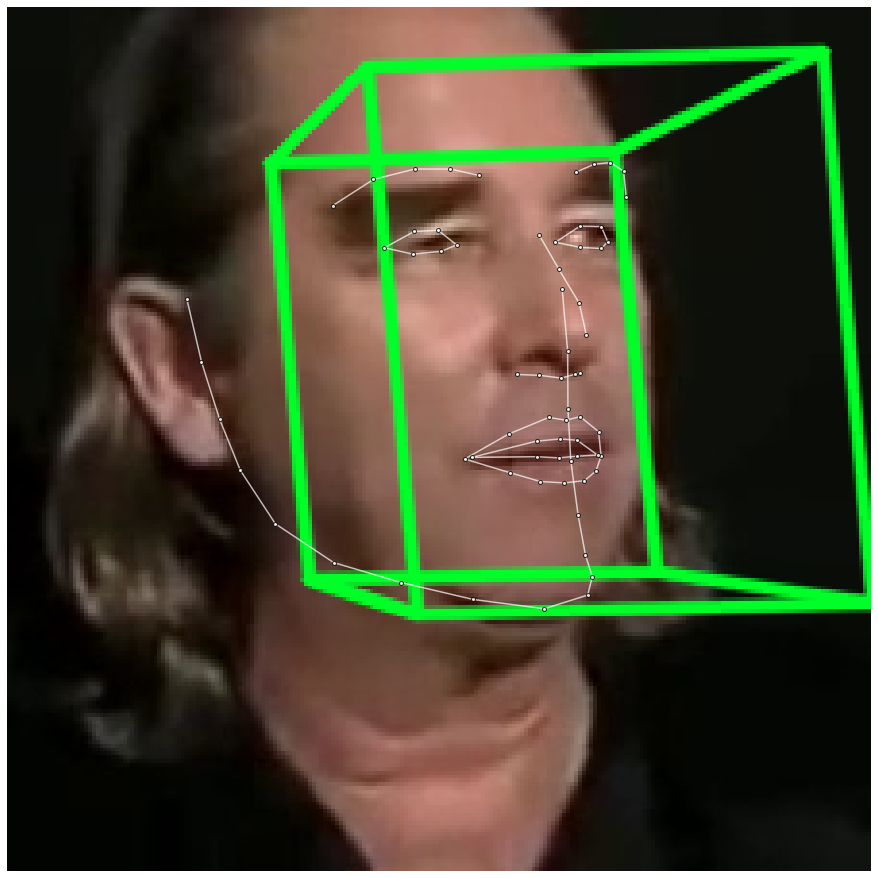

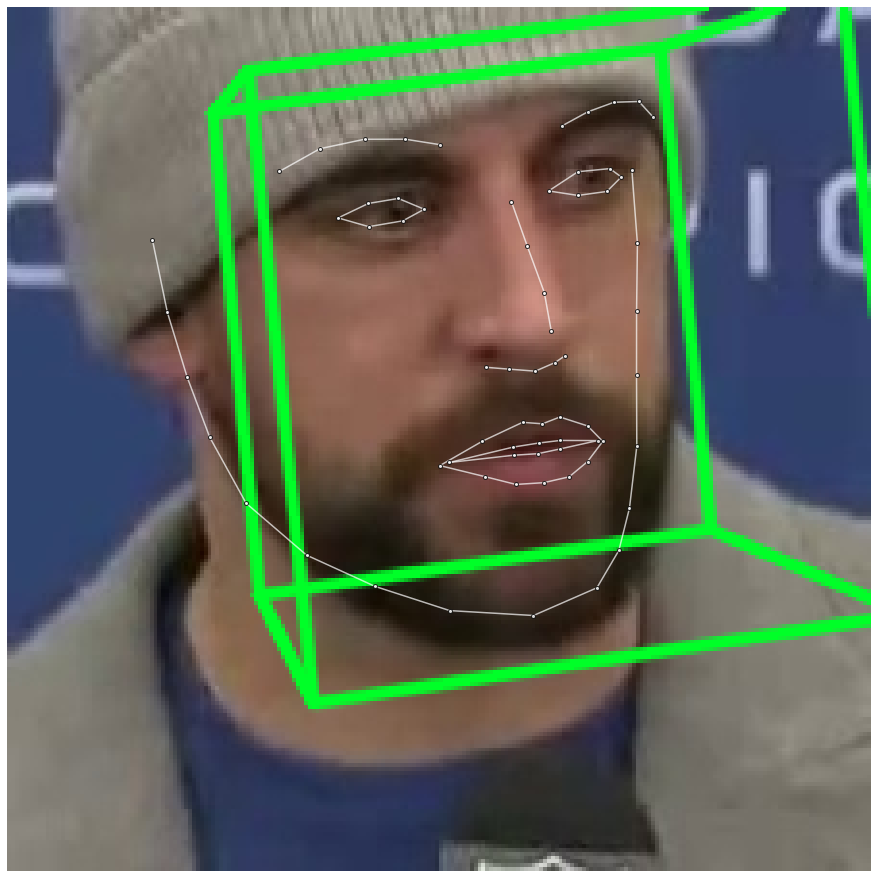

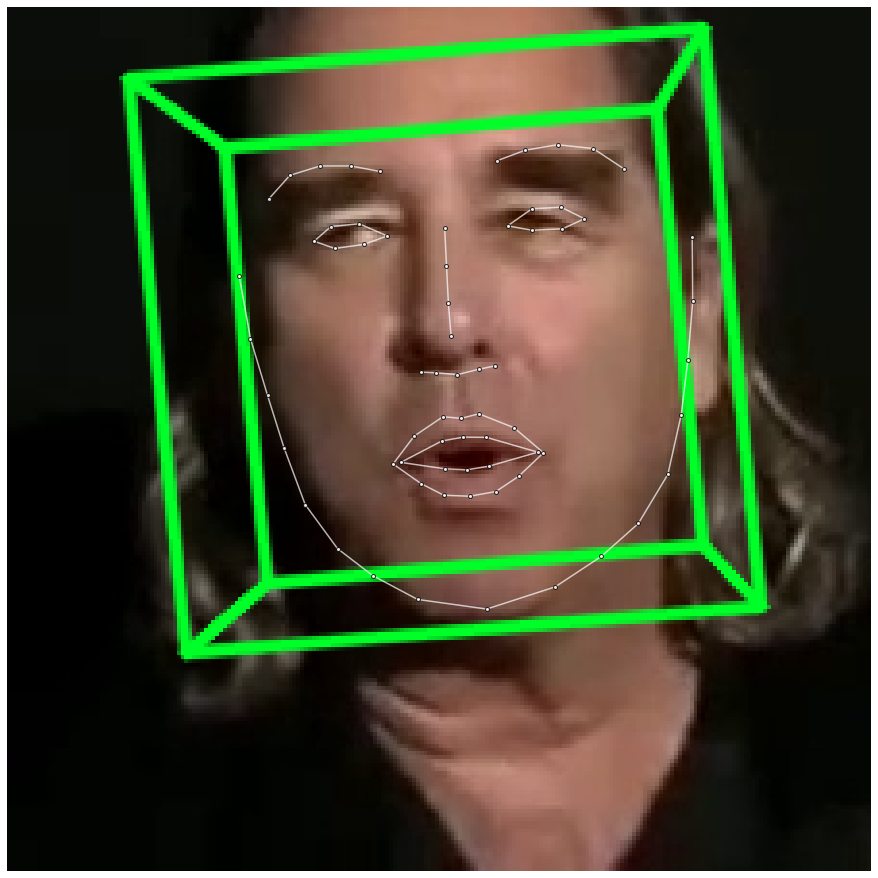

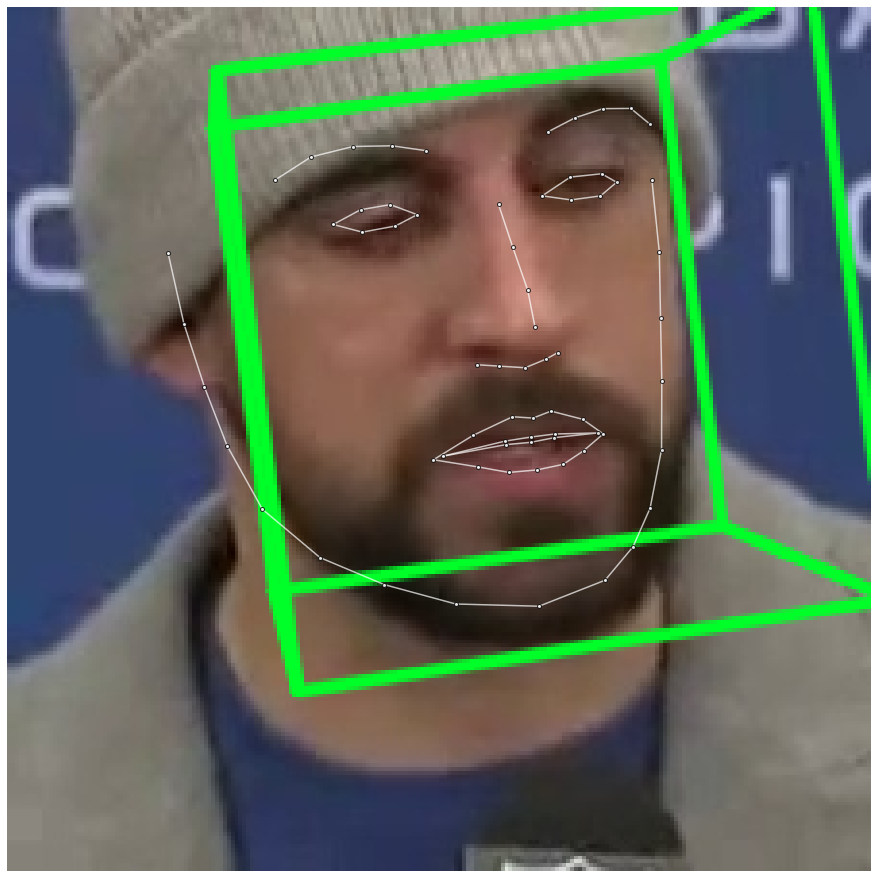

In [197]:
person = "id00126"
instance = "----"
video = "00053"

dataset = create_video_df()

for frame in tqdm(frame_file_locations):
    img = cv2.imread(frame)
    try:
        # Optimize for 3DDM parameters.
        param_lst, roi_box_lst = tddfa(img, boxes)
        # We don't need all landmarks for now.
        dense_flag = False

        ver_lst = tddfa.recon_vers(param_lst, roi_box_lst, dense_flag=dense_flag)
        P, pose = calculate_pose(img)
        
        dataset = add_to_video_df(dataset, instance, person, video, frame, pose)
        render_pose(img, param_lst, ver_lst, verbose=True)
        draw_landmarks(img, ver_lst, dense_flag=dense_flag)
    except:
        pass
    


In [191]:
dataset

,person_id,instance_id,video_id,frame_id,pose
0,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
1,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
2,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
3,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
4,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[-0.548054995899708, -30.96375653207351, 43.38..."
...,...,...,...,...,...
114,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
115,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
116,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"
117,jgOKAmhxq8s,id00926,00117,/Users/strezoski/Projects/ml/datasets/frames/f...,"[0.0, 0.0, 45.0]"


# Pablo notes

1. For every video add the path where the frames are stored.
2. Create a firebase for lookups in the dataframes by video_id.

### Data Visualization for potential interface

Bokeh - https://docs.bokeh.org/en/latest/docs/gallery.html (Python 
